# **Credit Card Fraud Detection**

![logo](images/credit-card-fraud-detection.webp)

## Introdução

O objetivo deste projeto é desenvolver um modelo de *Machine Learning* capaz de identificar transações fraudulentas em cartões de crédito. Usando informações disponíveis, o modelo aprenderá a diferenciar as transações legítimas das fraudulentas.

O modelo vai ser desenvolvido utilizando a linguagem **Python** e vai ser testado e treinado com dados de um *dataset* disponível no [Kaggle](https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud).

A abordagem realizada seguirá a metodologia **CRISP-DM** (Cross-Industry Standard Process for Data Mining), que inclui as seguintes etapas: compreensão do tema, compreensão dos dados, preparação dos dados, modelação e avaliação.

## Estrutura do Projeto

O projeto é composto por:

- **task1.py**: código desenvolvido para a compreensão do tema e dos dados e para a preparação dos dados.
- **task2.py**: código desenvolvido para a modelação e avaliação do modelo.
- **task3.py**: código desenvolvido para a competição kaggle.
- images: pasta com as imagens utilizadas no projeto.
- CreditCardFraudDetection: pasta com o *dataset* utilizado no projeto.

## Tecnologias Utilizadas

Como já foi referido, a linguagem de programação utilizada será o *Python* e as bibliotecas utilizadas foram:

- *Matplotlib* e *Seaborn* para visualização dos dados;
- *Pandas* para manipulação dos dados;
- *NumPy* para tratar os dados númericos;
- *Scikit-learn* para desenvolver o modelo de *Machine Learning*.

In [1283]:
import matplotlib.pyplot as plt
import seaborn as sb
import pandas as pd
import numpy as np
import folium
from scipy.stats import chi2_contingency
from datetime import datetime
import re
from sklearn.impute import KNNImputer
from sklearn.metrics import silhouette_score
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV, StratifiedKFold

import warnings
%matplotlib inline
warnings.filterwarnings('ignore')

## Compreensão do Tema
 
Os cartões de crédito são atualmente um dos meios de pagamento mais adotados, especialmente com a expansão do comércio online. Contudo, essa evolução aumentou a exposição dos utilizadores a fraudes, sendo a segurança um aspeto essencial tanto para as instituições financeiras quanto para os consumidores.

Este problema tem como objetivo prever se uma transação de cartão de crédito é **legítima** ou **fraudulenta**, utilizando um *dataset*. A necessidade principal é identificar transações suspeitas com precisão, de forma a prevenir impactos negativos financeiros.

O objetivo do modelo consiste em classificar cada transação num dos dois grupos mutuamente exclusivos:
- **Legítima**: Transação autorizada, realizada pelo titular do cartão.
- **Fraudulenta**: Transação não autorizada, efetuada por terceiros.

Para abordar o problema, será desenvolvido um modelo de *machine learning* especializado em classificação binária, capaz de distinguir transações legítimas das fraudulentas com alto grau de precisão. 

O modelo será treinado utilizando uma abordagem de *supervised learning*, com a meta de alcançar uma alta taxa de precisão e recall nos dados de teste, assegurando eficácia prática e capacidade de minimizar falsos positivos e falsos negativos na deteção de fraudes.

## Compreensão dos Dados

Antes de começar a compreender os dados, é necessário importar os vários ficheiros e juntá-los num único *dataset*.

In [1284]:
cities = pd.read_csv('CreditCardTransactions/cities.csv')
customers = pd.read_csv('CreditCardTransactions/customers.csv')
merchants = pd.read_csv('CreditCardTransactions/merchants.csv')
transactions = pd.read_csv('CreditCardTransactions/transactions.csv')

# Merge do customers.csv e cities.csv usando 'city'
customers_cities = pd.merge(customers, cities, on='city', how='left')

# Merge do transactions.csv e customers_cities usando 'cc_num'
transactions_customers = pd.merge(transactions, customers_cities, on='cc_num', how='left')

# Merge final do transactions_customers e merchants.csv usando 'merchant'
final_data = pd.merge(transactions_customers, merchants, on='merchant', how='left')

# Guardar o resultado final
final_data.to_csv('CreditCardTransactions/merged_dataset.csv', index=False)

data = pd.read_csv('CreditCardTransactions/merged_dataset.csv')

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   index                  30000 non-null  int64  
 1   trans_date_trans_time  29900 non-null  object 
 2   cc_num                 30000 non-null  int64  
 3   device_os              12036 non-null  object 
 4   merchant               30000 non-null  object 
 5   amt                    29900 non-null  float64
 6   trans_num              30000 non-null  object 
 7   unix_time              30000 non-null  int64  
 8   is_fraud               30000 non-null  int64  
 9   first                  29990 non-null  object 
 10  last                   29990 non-null  object 
 11  gender                 29990 non-null  object 
 12  street                 29990 non-null  object 
 13  city                   29990 non-null  object 
 14  zip                    29784 non-null  float64
 15  jo

O *dataset* é constituído por **30000** entradas e **25** colunas. Cada entrada representa uma transação de cartão de crédito. As colunas contêm informações sobre a transação, como o valor, a data, a localização, entre outros que vamos ver com detalhe mais à frente.

Além disso, a dimensionalidade parece adequada para o problema em questão e, tendo em conta que os dados parecem ser consistentes e provenientes da mesma fonte, não se espera encontrar problemas significativos de compatibilidade ou coerência.

In [1285]:
data.head()

,index,trans_date_trans_time,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,first,...,job,dob,lat,long,city_pop,state,category,merch_lat,merch_long,merchant_id
0,5381,2023-01-01 00:39:03,2801374844713453,NaN,Merchant_85,252.75,TRANS_662964,1672533543,0,Jane,...,NaN,2002-10-12,41.8781,-87.6298,2716000.0,IL,NaN,NaN,76.433212,85.0
1,4008,2023-01-01 01:16:08,3460245159749480,NaN,Merchant_23,340.17,TRANS_134939,1672535768,0,Alice,...,Nurse,2001-12-23,40.7128,-74.0060,8419600.0,NY,Entertainment,27.177588,-64.857435,23.0
2,1221,2023-01-01 01:24:28,7308701990157768,macOS,Merchant_70,76.38,TRANS_258923,1672536268,0,Bob,...,Doctor,1978-12-13,33.4484,-112.0740,1680992.0,AZ,Electronics,31.730070,-67.777407,70.0
3,9609,2023-01-01 02:06:57,8454886440761098,X11,Merchant_33,368.88,TRANS_226814,1672538817,0,Mike,...,Teacher,1965-04-21,33.4484,-112.0740,1680992.0,AZ,Electronics,-5.005953,146.873847,33.0
4,5689,2023-01-01 02:10:54,6350332939133843,NaN,Merchant_90,323.32,TRANS_668449,1672539054,0,Mike,...,Nurse,1997-05-17,40.7128,-74.0060,8419600.0,NY,Groceries,79.065894,40.668693,90.0


Assim, vamos analisar com mais detalhe os atributos do *dataset*.

| **Atributo**            | **Tipo**        | **Significado**                                                  |
|--------------------------|-------------------------|-------------------------------------------------------------------|
| `index`                  | Categório Nominal  | Identificador único para cada linha do dataset                |
| `trans_date_trans_time`  | Categórico Ordinal  | Data e hora da transação                           |
| `cc_num`                 | Categório Nominal  | Número do cartão de crédito utilizado na transação               |
| `device_os`              | Categórico Nominal     | Sistema operativo do dispositivo utilizado para a transação    |
| `merchant`               | Categórico Nominal     | Nome/Identificador do comerciante                             |
| `amt`                    | Numérico Ratio     | Valor da transação (em unidades monetárias)                      |
| `trans_num`              | Categórico Nominal    | Identificador único para cada transação                          |
| `unix_time`              | Numérico Intervalo    | Timestamp Unix que representa a data e hora da transação         |
| `is_fraud`               | Categório Nominal     | Indicador de fraude na transação (`0`: Não fraudulenta, `1`: Fraudulenta) |
| `first` e `last`         | Categórico Nominal     | Primeiro e último nome do titular do cartão                      |
| `gender`                 | Categórico Nominal     | Género do titular do cartão                                       |
| `street`                 | Categórico Nominal     | Nome da rua                                                      |
| `city`                   | Categórico Nominal     | Cidade do cliente                                                |
| `zip`                    | Categório Nominal   | Código postal                                                    |
| `state`                  | Categórico Nominal     | Estado                                                           |
| `job`                    | Categórico Nominal     | Profissão do titular do cartão                                   |
| `dob`                    | Categórico Ordinal | Data de nascimento do titular do cartão                          |
| `lat` e `long`           | Numérico Ratio     | Latitude e longitude da localização do cliente                   |
| `city_pop`               | Numérico Ratio     | População da cidade onde o cliente reside                        |
| `category`               | Categórico Nominal     | Categoria do comerciante                                         |
| `merch_lat` e `merch_long`| Numérico Ratio     | Latitude e longitude do comerciante                              |
| `merchant_id`            | Categórico Nominal   | Identificador único do comerciante                               |

Os atributos **device_os**, **amt**, **unix_time**/**trans_data_trans_time**, **gender**, **job**, **category**, **city**, **cc_num**, **merchant**/**merchant_id**, **trans_num** e **dob** parecem ser os mais relevantes para detetar fraude, pois parecem ter mais relação com a variável alvo **is_fraud**. Estes serão mais analisados e tratados nas próximas etapas.

Existem, também, vários atributos relacionados com a localização, como por exemplo, **lat**, **long**, **city_pop**, **zip**, **state**, **street**, **merch_lat** e **merch_long**. Estes atributos podem ser úteis para o modelo, contudo é necessário analisar a relevância e a correlação com a variável alvo e perceber se são todos necessários, pois parecem ser redundantes quando usados em conjunto.

Em contrapartida, os atributos **index**, **first** e **last** são irrelevantes para o modelo, pois são identificadores únicos/informações que não têm relação com a variável alvo. Deverão, portanto, ser removidos numa próxima etapa.

In [1286]:
data.dtypes

index                      int64
trans_date_trans_time     object
cc_num                     int64
device_os                 object
merchant                  object
amt                      float64
trans_num                 object
unix_time                  int64
is_fraud                   int64
first                     object
last                      object
gender                    object
street                    object
city                      object
zip                      float64
job                       object
dob                       object
lat                      float64
long                     float64
city_pop                 float64
state                     object
category                  object
merch_lat                float64
merch_long               float64
merchant_id              float64
dtype: object

Alguns atributos são reconhecidos como numéricos pelo **Python**, mas devem ser tratados como categóricos. Por isso, é necessário convertê-los para o tipo adequado.

In [1287]:
data['index'] = data['index'].astype('object')
data['cc_num'] = data['cc_num'].astype('object')
data['is_fraud'] = data['is_fraud'].astype('object')
data['zip'] = data['zip'].astype('object')
data['merchant_id'] = data['merchant_id'].astype('object')

Para sumarizar os dados foram calculadas algumas estatística das variáveis que parecem ter maior relevância para a deteção de fraude.

Os valores médios das transações fraudulentas (253.25) e não fraudulentas (250.00) são muito próximos, o que indica que o montante médio não é, por si só, um indicador significativo de fraude. No entanto, a análise dos quartis revela uma leve tendência das transações fraudulentas terem valores um pouco mais altos, como evidenciado pela mediana, que é ligeiramente maior nos casos fraudes (256.65 contra 249.53).

Outro ponto relevante é o desvio padrão das transações. As fraudulentas possuem um desvio padrão ligeiramente menor (138.69), sugerindo que os valores de fraudes são menos variados e mais concentrados. Além disso, os valores mínimos das fraudes (2.39) são maiores do que os das transações não fraudulentas (1.01), indicando que transações fraudulentas tendem a não ocorrer em valores extremamente baixos.

A seguir, apresentamos um gráfico de bigodes que ilustra de forma clara as observações mencionadas, destacando as pequenas diferenças entre transações fraudulentas e não fraudulentas na variável **amt**.

In [1288]:
fraud_stats = {
    'Não Fraude': data[data['is_fraud'] == 0]['amt'].describe(),
    'Fraude': data[data['is_fraud'] == 1]['amt'].describe()
}

fraud_stats_df = pd.DataFrame(fraud_stats)
print(fraud_stats_df)

         Não Fraude      Fraude
count  29331.000000  569.000000
mean     250.001425  253.252179
std      144.210626  138.693670
min        1.010000    2.390000
25%      125.100000  132.010000
50%      249.530000  256.650000
75%      375.425000  369.800000
max      499.970000  499.520000


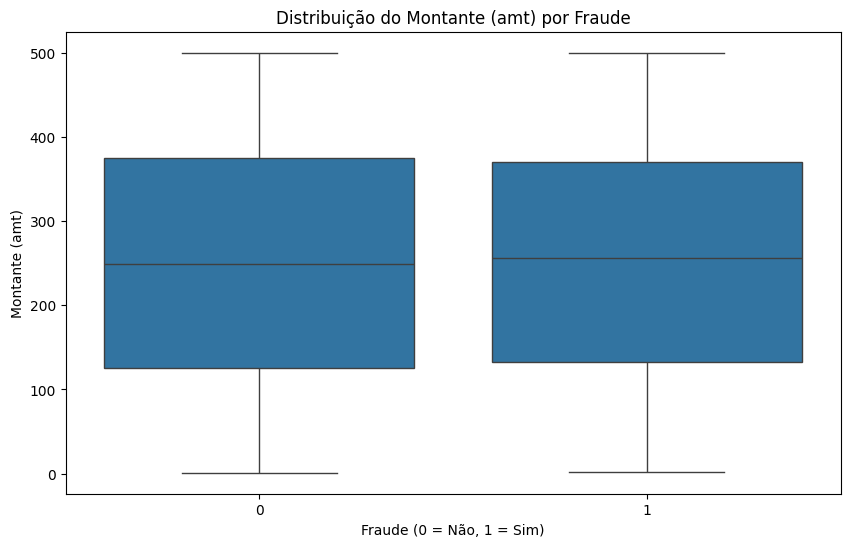

In [1289]:
plt.figure(figsize=(10, 6))
sb.boxplot(x=data['is_fraud'], y=data['amt'], data=data) 
plt.title('Distribuição do Montante (amt) por Fraude')
plt.xlabel('Fraude (0 = Não, 1 = Sim)')
plt.ylabel('Montante (amt)')

plt.show()

A incidência de casos de fraude é relativamente baixa, com uma média de 0.019, o que sugere que aproximadamente 1.9% das transações são fraudulentas. Isto revela que o *dataset* não é equilibrado, pois contém poucas transações fraudulentas em comparação com as legítimas.

In [1290]:
data['is_fraud'].mean()

0.019033333333333333

A análise mostra que a distribuição do **unix_time** é muito similar entre fraudes e não fraudes. As medianas, os quartis e os limites extremos são praticamente idênticos.

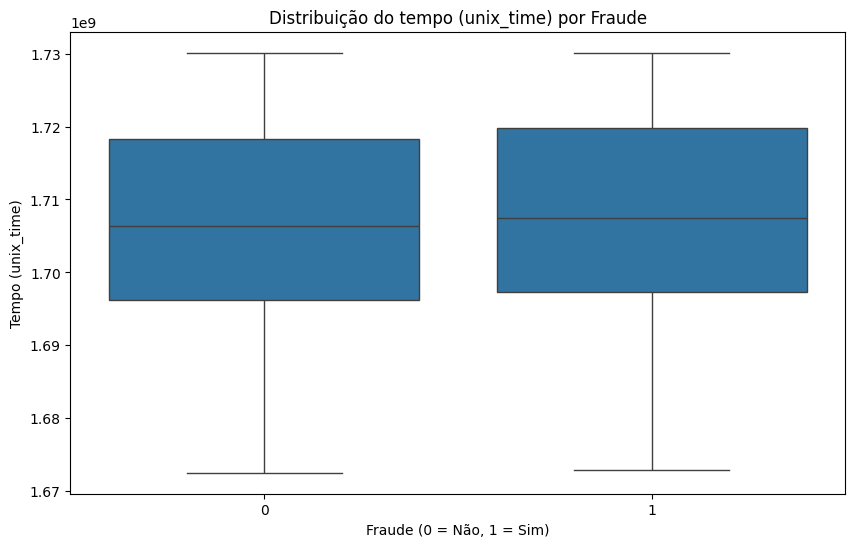

In [1291]:
plt.figure(figsize=(10, 6))
sb.boxplot(x=data['is_fraud'], y=data['unix_time'], data=data) 
plt.title('Distribuição do tempo (unix_time) por Fraude')
plt.xlabel('Fraude (0 = Não, 1 = Sim)')
plt.ylabel('Tempo (unix_time)')

plt.show()

Para explorar melhor esta variável, pode ser útil analisá-la em mais detalhe, como dias da semana e horários.

A diferença na quantidade de fraudes entre dias úteis e finais de semana é perceptível. Dias úteis apresentam consistentemente mais fraudes, ao contrário dos fins de semana que têm uma redução significativa. Os dias com mais fraudes são segunda, seguida de terça e sexta.

In [1292]:
# Criar uma nova coluna 'day_of_week' com o dia da semana da transação
data_copy = data.copy()
data_copy['trans_date_trans_time'] = pd.to_datetime(data_copy['unix_time'], unit='s')

data_copy['day_of_week'] = data_copy['trans_date_trans_time'].dt.day_name()

fraud_table = data_copy.groupby(['day_of_week', 'is_fraud']).size().unstack(fill_value=0)
fraud_table.columns = ['Não Fraude', 'Fraude']

# Criar tabela de visualização
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
fraud_table = fraud_table.reindex(ordered_days, fill_value=0)

fraud_table = fraud_table.sort_values(by='Fraude', ascending=False)

print(fraud_table)

             Não Fraude  Fraude
day_of_week                    
Monday             4315      93
Tuesday            4169      92
Friday             4162      92
Thursday           4251      86
Wednesday          4081      77
Saturday           4242      71
Sunday             4209      60


A maior quantidade de fraudes ocorre entre as 8h, 2h e 18h. Existe uma correlação entre horários com maior volume total de transações e o número de fraudes, sugerindo que os atacantes podem explorar momentos de maior movimentação para passarem despercebidos nas transações legítimas.

In [1293]:
# Criar uma nova coluna 'hour' com a hora da transação
temp_data = data.copy()

temp_data['datetime'] = pd.to_datetime(temp_data['unix_time'], unit='s')

# ===== 3. Adicionar hora =====
temp_data['hour'] = temp_data['datetime'].dt.hour
# Definir a função para categorizar o período do dia
def categorize_period(hour):
    if 0 <= hour < 8:
        return 'Madrugada'
    elif 8 <= hour < 13:
        return 'Manhã'
    elif 13 <= hour < 18:
        return 'Tarde'
    else:
        return 'Noite'

# Adicionar a coluna 'period_of_day' sem modificar o dataset original
temp_data = temp_data.assign(
    period_of_day=temp_data['hour'].apply(categorize_period)
)

# Calcular estatísticas por período do dia
period_stats = temp_data.groupby('period_of_day')['is_fraud'].agg(
    total_frauds='sum',
    total_transactions='count',
    fraud_rate=lambda x: x.sum() / len(x) * 100  # Taxa de fraudes (%)
).reset_index()

# Exibir as estatísticas com print detalhado
for _, row in period_stats.iterrows():
    print(f"Period of Day: {row['period_of_day']}")
    print(f"  Total Frauds: {row['total_frauds']}")
    print(f"  Total Transactions: {row['total_transactions']}")
    print(f"  Fraud Rate: {row['fraud_rate']:.2f}%")
    print("-" * 40)

Period of Day: Madrugada
  Total Frauds: 186
  Total Transactions: 10074
  Fraud Rate: 1.85%
----------------------------------------
Period of Day: Manhã
  Total Frauds: 128
  Total Transactions: 6259
  Fraud Rate: 2.05%
----------------------------------------
Period of Day: Noite
  Total Frauds: 149
  Total Transactions: 7500
  Fraud Rate: 1.99%
----------------------------------------
Period of Day: Tarde
  Total Frauds: 108
  Total Transactions: 6167
  Fraud Rate: 1.75%
----------------------------------------


A variação nas taxas de fraude entre as cidades não é muito grande (1,351% a 1,998%), mas cidades como *Test City* e *Chicago* destacam-se por estarem consistentemente acima da média geral.

In [1294]:
data.groupby('city')['is_fraud'].mean().sort_values(ascending=False)

city
Test City       0.01998
Chicago        0.019392
Phoenix        0.018344
Houston        0.017751
Los Angeles    0.016506
New York       0.013506
Name: is_fraud, dtype: object

O maior índice de fraudes em *macOS* e *windows* pode estar relacionado com as características específicas desses sistemas ou com o perfil do atacante. Apesar do *Linux* e *Windows* apresentarem taxas mais baixas, a diferença não é significativa.

In [1295]:
data.groupby('device_os')['is_fraud'].sum().sort_values(ascending=False)

device_os
macOS      69
other      63
Windows    62
X11        32
Linux      28
Name: is_fraud, dtype: object

*Groceries* tem a maior taxa de fraudes (2,06%), seguida do *Entertainment* (2,02%) e *Apparel* (1,98%).
As diferenças entre as taxas de fraude por categoria são relativamente pequenas, variando entre 1,73% e 2,06%.

In [1296]:
data.groupby('category')['is_fraud'].mean().sort_values(ascending=False)

category
Groceries        0.020576
Entertainment    0.020163
Apparel          0.019774
Electronics      0.018179
Travel           0.017302
Name: is_fraud, dtype: object

*Clerk* (2,19%) apresenta a maior taxa de fraude, seguido de *Lawyer* (2,05%) e *Doctor* (1,83%).
As taxas de fraude por profissão variam entre 1,63% e 2,19%, com diferenças relativamente pequenas, mas ainda assim podem ser relevantes para identificar padrões.

In [1297]:
data.groupby('job')['is_fraud'].mean().sort_values(ascending=False)

job
Clerk       0.021894
Lawyer      0.020487
Doctor      0.018364
Engineer    0.017801
Artist      0.017517
Teacher     0.017404
Nurse        0.01626
Name: is_fraud, dtype: object

Embora a diferença não seja muito grande, há um número maior de fraudes relacionadas a indivíduos do género feminino.

In [1298]:
data.groupby('gender')['is_fraud'].sum().sort_values(ascending=False)

gender
F    300
M    271
Name: is_fraud, dtype: object

In [1299]:
# Calcular faixas etárias inline
def categorize_age(dob):
    today = datetime.today()
    age = today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))
    if 18 <= age <= 36:
        return 'Young Adult'
    elif 37 <= age <= 55:
        return 'Adult'
    elif 56 <= age <= 74:
        return 'Middle Age'
    else:
        return 'Senior'

# Adicionar cálculo de idades e estatísticas
fraud_stats = data.assign(
    dob=pd.to_datetime(data['dob']),  # Garantir formato datetime para 'dob'
    age=lambda df: df['dob'].apply(
        lambda dob: datetime.today().year - dob.year - ((datetime.today().month, datetime.today().day) < (dob.month, dob.day))
    ),  # Calcular idade
    age_category=lambda df: df['dob'].apply(categorize_age)
).groupby('age_category').agg(
    total_frauds=('is_fraud', 'sum'),
    total_transactions=('is_fraud', 'count'),
    fraud_rate=('is_fraud', lambda x: x.sum() / len(x) * 100),  # Taxa de fraudes (%)
    min_age=('age', 'min'),
    max_age=('age', 'max')
).reset_index()

# Exibir os resultados detalhados
for _, row in fraud_stats.iterrows():
    print(f"Age Category: {row['age_category']}")
    print(f"  Total Frauds: {row['total_frauds']}")
    print(f"  Total Transactions: {row['total_transactions']}")
    print(f"  Fraud Rate: {row['fraud_rate']:.2f}%")
    print(f"  Min Age: {row['min_age']}")
    print(f"  Max Age: {row['max_age']}")
    print("-" * 40)


Age Category: Adult
  Total Frauds: 192
  Total Transactions: 9875
  Fraud Rate: 1.94%
  Min Age: 37.0
  Max Age: 55.0
----------------------------------------
Age Category: Middle Age
  Total Frauds: 209
  Total Transactions: 11849
  Fraud Rate: 1.76%
  Min Age: 56.0
  Max Age: 74.0
----------------------------------------
Age Category: Senior
  Total Frauds: 0
  Total Transactions: 10
  Fraud Rate: 0.00%
  Min Age: nan
  Max Age: nan
----------------------------------------
Age Category: Young Adult
  Total Frauds: 170
  Total Transactions: 8266
  Fraud Rate: 2.06%
  Min Age: 18.0
  Max Age: 36.0
----------------------------------------


Podemos verificar que existe uma incidência de fraude bastante superior nalguns **merchants** em comparação com outros. Mais à frente, podemos criar variáveis que vão representar a relação dos **comerciantes** com os **clientes**.

In [1300]:
data.groupby('merchant')['is_fraud'].sum().sort_values(ascending=False)

merchant
Merchant_38         13
Merchant_76         12
Merchant_58         11
Merchant_45         11
Merchant_62         11
                    ..
Merchant_29          2
Merchant_15          2
Merchant_99          2
Merchant_21          1
Unknown_Merchant     0
Name: is_fraud, Length: 101, dtype: object

Nesta fase da exploração dos dados, vão ser criados alguns gráficos para os atributos considerados mais relevantes, tendo em vista a extração de novas conclusões.

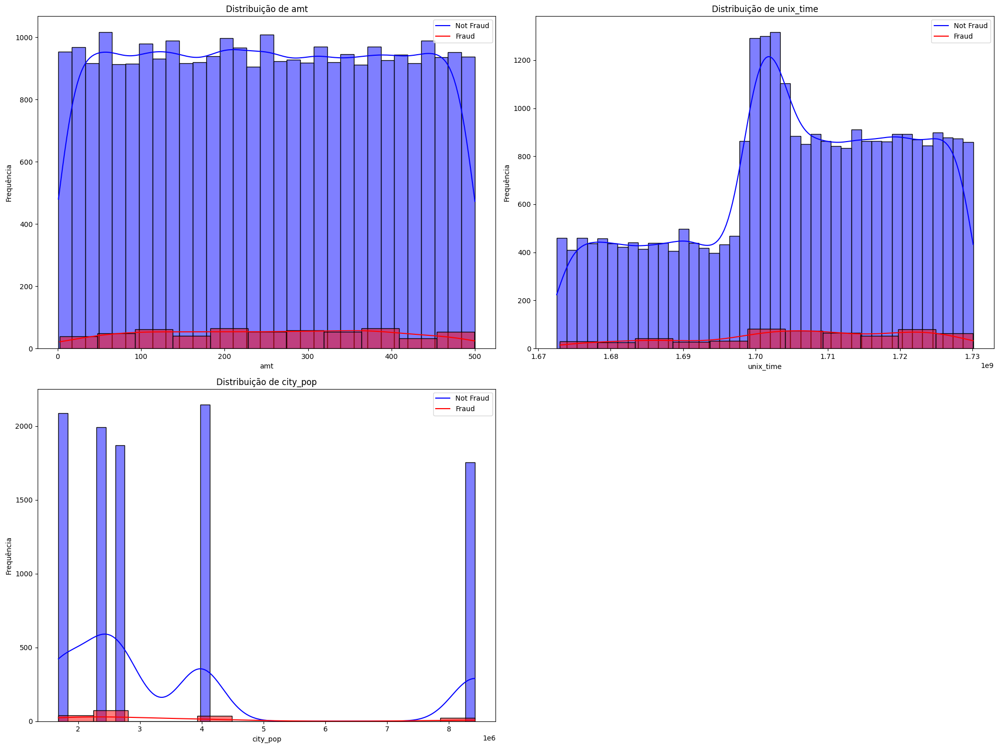

In [1301]:
plt.figure(figsize = (20, 15))

is_fraud = data[data['is_fraud'] == 1][['amt', 'unix_time', 'city_pop']]
is_not_fraud = data[data['is_fraud'] == 0][['amt', 'unix_time', 'city_pop']]

# Iterar sobre as colunas numéricas e criar gráficos
for i, col in enumerate(is_fraud.columns):
    plt.subplot(2, 2, i + 1)
    sb.histplot(data=is_not_fraud[col], label='Not Fraud', color='blue', kde=True, alpha=0.5)
    sb.histplot(data=is_fraud[col], label='Fraud', color='red', kde=True, alpha=0.5)
    plt.legend(plt.gca().get_legend_handles_labels()[1])
    plt.title(f"Distribuição de {col}")
    plt.xlabel(col)
    plt.ylabel("Frequência")

plt.tight_layout()
plt.show()

Transações fraudulentas tendem a estar distribuídas ao longo do intervalo de valores **amt**, mas têm picos menores em comparação com transações legítimas.

Seguem o mesmo padrão geral do **horário da transação** que as legítimas, com uma distribuição mais concentrada em torno de certos horários (aumenta consideravelmente em 1.70 na escala do gráfico).

Transações fraudulentas aparecem em cidades com diferentes populações, mas são mais frequentes em cidades pequenas e grandes.

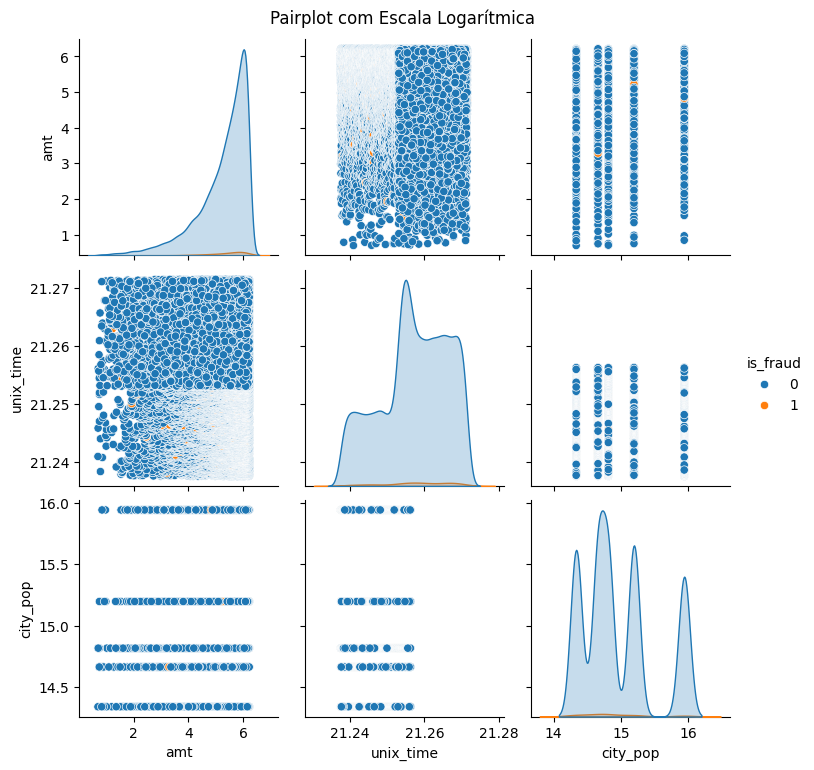

In [1302]:
data_log_scaled = data[['amt', 'unix_time', 'city_pop', 'is_fraud']].copy()

# Escala logarítmica
for col in ['amt', 'unix_time', 'city_pop']:
    data_log_scaled[col] = np.log1p(data_log_scaled[col])

# Criar o pairplot
sb.pairplot(data_log_scaled, hue='is_fraud', diag_kind='kde', height=2.5)
plt.suptitle("Pairplot com Escala Logarítmica", y=1.02)
plt.show()

Estes novos gráficos não nos acrescentam mais informação do que aquela que já tínhamos, mas ajudam a reforçar as conclusões anteriores.

In [1303]:
# Criar o mapa sem valores inválidos
mapa = folium.Map(location=[20, 0], zoom_start=2)
mapa_data = data.dropna(subset=['lat', 'long', 'merch_lat', 'merch_long'])

# Adicionar as localizaçoes dos comerciantes
for _, row in mapa_data.iterrows():
    folium.CircleMarker(
        location=[row['merch_lat'], row['merch_long']],
        radius=6,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        popup=f"Comerciante: ({row['merch_lat']}, {row['merch_long']})"
    ).add_to(mapa)

# Adicionar as localizações dos utilizadores
for _, row in mapa_data.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=6,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.7,
        popup=f"Utilizador: ({row['lat']}, {row['long']})"
    ).add_to(mapa)

mapa

Para entender melhor os valores de latitude e longitude foi criada a visualização acima. Os pontos a **azul** identificam as localizações dos **clientes** e os pontos a **vermelho** as localizações dos **comerciantes**.

A primeira observação que podemos retirar é que existe mais informação da localização dos comerciantes e que existem vários pontos em sítios que não fazem muito sentido, por exemplo, no meio do mar. Podemos concluir que parece que só a latitude e a longitude não nos darão muita informação relevante para a deteção de fraude, mas será interessante combinar estes atributos com outros para perceber se existe alguma relação.

Quando a distância entre os pontos de localização é grande ou inesperada, especialmente num curto intervalo de tempo, pode-se identificar anomalias que indicam possíveis fraudes. Por exemplo, se um utilizador legítimo está localizado numa cidade, mas uma transação ocorre num local muito distante, isso pode sugerir que os dados do cartão foram comprometidos.

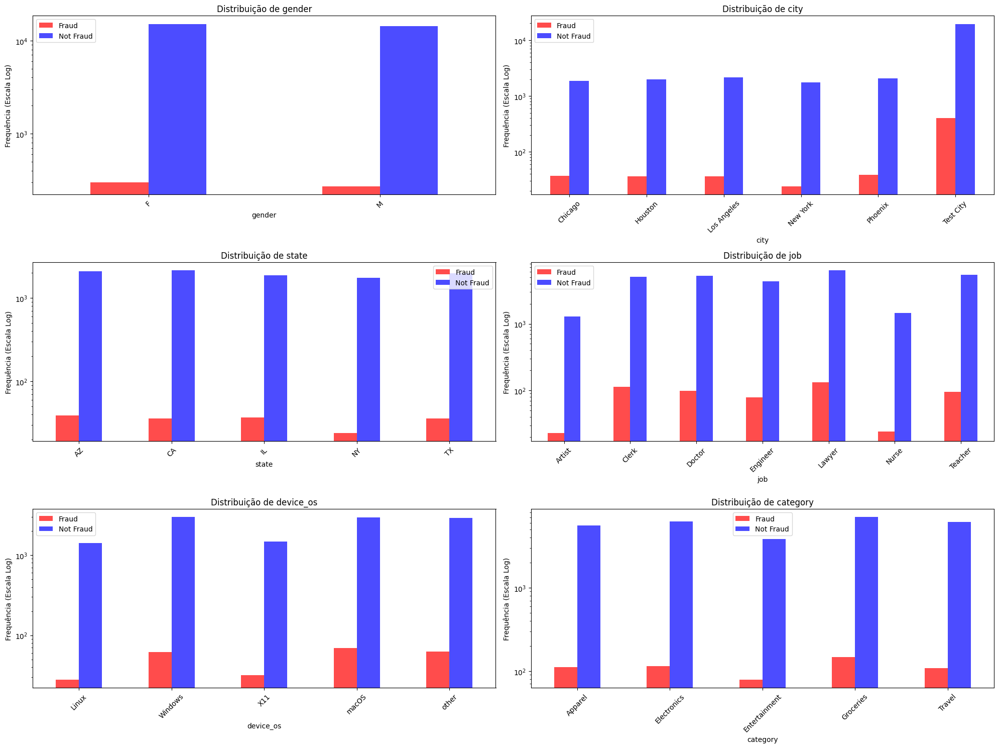

In [1304]:
plt.figure(figsize=(20, 15))

is_fraud = data[data['is_fraud'] == 1][['gender', 'city', 'state', 'job', 'device_os', 'category']]
is_not_fraud = data[data['is_fraud'] == 0][['gender', 'city', 'state', 'job', 'device_os', 'category']]

# Iterar sobre as colunas categóricas e criar gráficos
for i, col in enumerate(is_fraud.columns):
    plt.subplot(3, 2, i + 1)
    
    fraud_counts = is_fraud[col].value_counts()
    not_fraud_counts = is_not_fraud[col].value_counts()
    
    combined = pd.DataFrame({
        'Fraud': fraud_counts,
        'Not Fraud': not_fraud_counts
    }).fillna(0)
    
    combined.plot(kind='bar', ax=plt.gca(), color=['red', 'blue'], alpha=0.7)
    plt.title(f"Distribuição de {col}")
    plt.xlabel(col)
    plt.ylabel("Frequência (Escala Log)")
    plt.yscale('log')  # Escala logarítmica
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

Ambos os **géneros** possuem uma proporção semelhante de fraudes em relação a transações legítimas, o mesmo com a variável **state**.

Como já visto, a cidade **Test City** tem uma proporção mais alta de fraude em relação às outras.

Certas profissões, como **Lawyer** e **Clerk**, têm volumes maiores de transações legítimas e fraudulentas. O mesmo quando temos em conta os sitemas operativos **macOs** e **windows**.

A variável **category** pode ser um bom indicador, especialmente em categorias específicas, como **Groceries** e **Electronics**, que podem ser mais suscetíveis a fraudes.

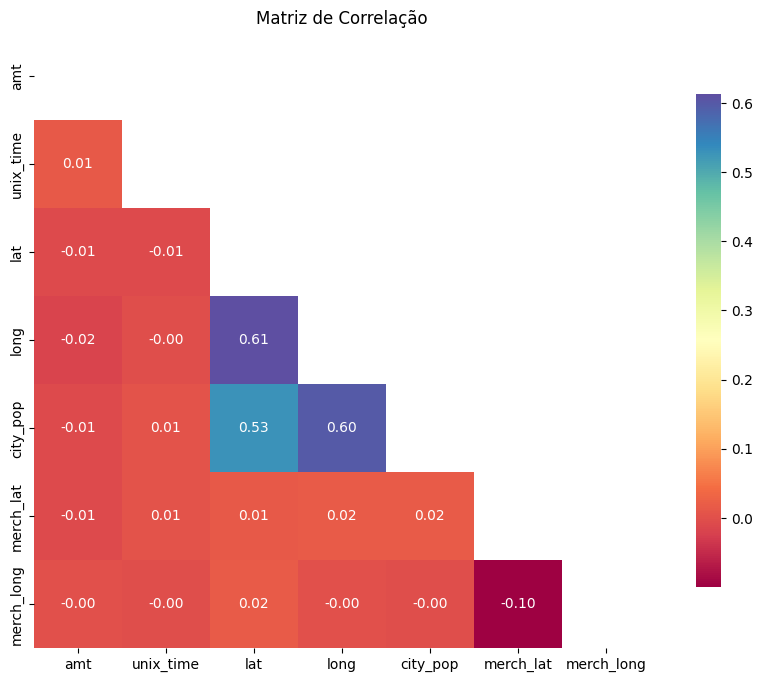

In [1305]:
numeric_data = data.select_dtypes(include=['float64', 'int64'])

# Criar a matriz de correlação de Pearson
correlation_matrix = numeric_data.corr()

# retirar a parte superior da matriz
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

plt.figure(figsize=(12, 8))
sb.heatmap(correlation_matrix, mask=mask, annot=True, fmt=".2f", cmap="Spectral", square=True, cbar_kws={"shrink": .8})

plt.title("Matriz de Correlação")
plt.show()

Todas as variáveis numéricas apresentam **correlação muito baixa**, exceto a **city_pop** com a **lat** e a **long**, além da relação entre **lat** e **long**, que mostram correlações moderadas. Isto sugere que algumas variáveis não apresentam uma relação linear direta forte, o que pode indicar que a fraude pode ser influenciadas por combinações mais complexas, em vez de relações isoladas ou lineares. Esta conclusão já tinha sido retirada para alguns atributos nos textos anteriores.

O mesmo se pode observar no gráfico abaixo da correlação de **Spearman**. Nenhuma das variáveis parece ter uma correlação monótona minimamente significativa tirando os casos já referidos acima.

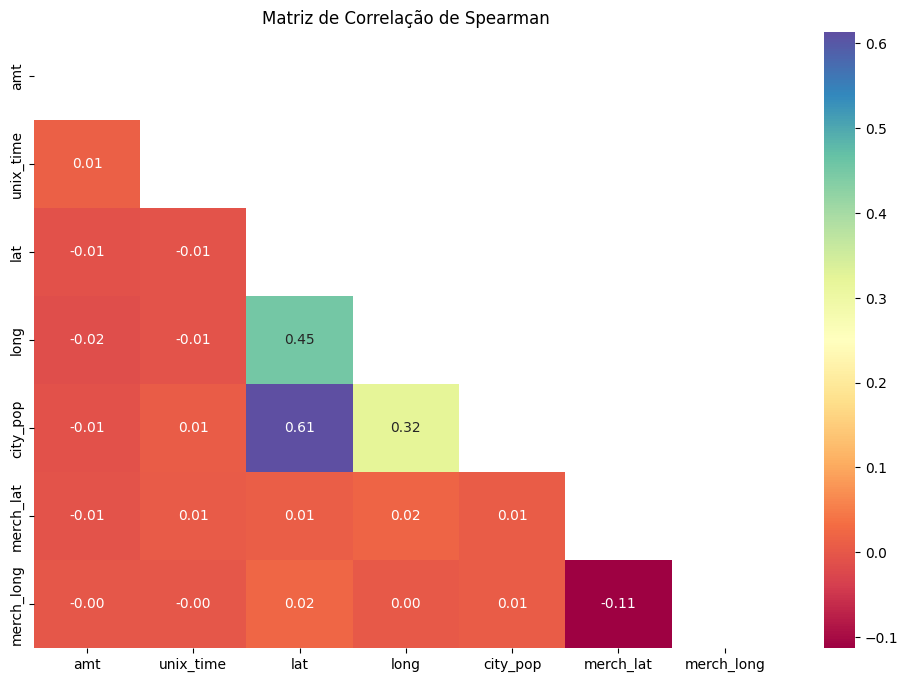

In [1306]:
numeric_data = data.select_dtypes(include=['float64', 'int64'])

# Calcular a matriz de correlação de Spearman
spearman_corr_matrix = numeric_data.corr(method='spearman')
mask = np.triu(np.ones_like(spearman_corr_matrix, dtype=bool))

# Criar o heatmap
plt.figure(figsize=(12, 8))
sb.heatmap(spearman_corr_matrix, mask=mask, annot=True, cmap='Spectral', fmt=".2f", cbar=True)
plt.title('Matriz de Correlação de Spearman')
plt.show()

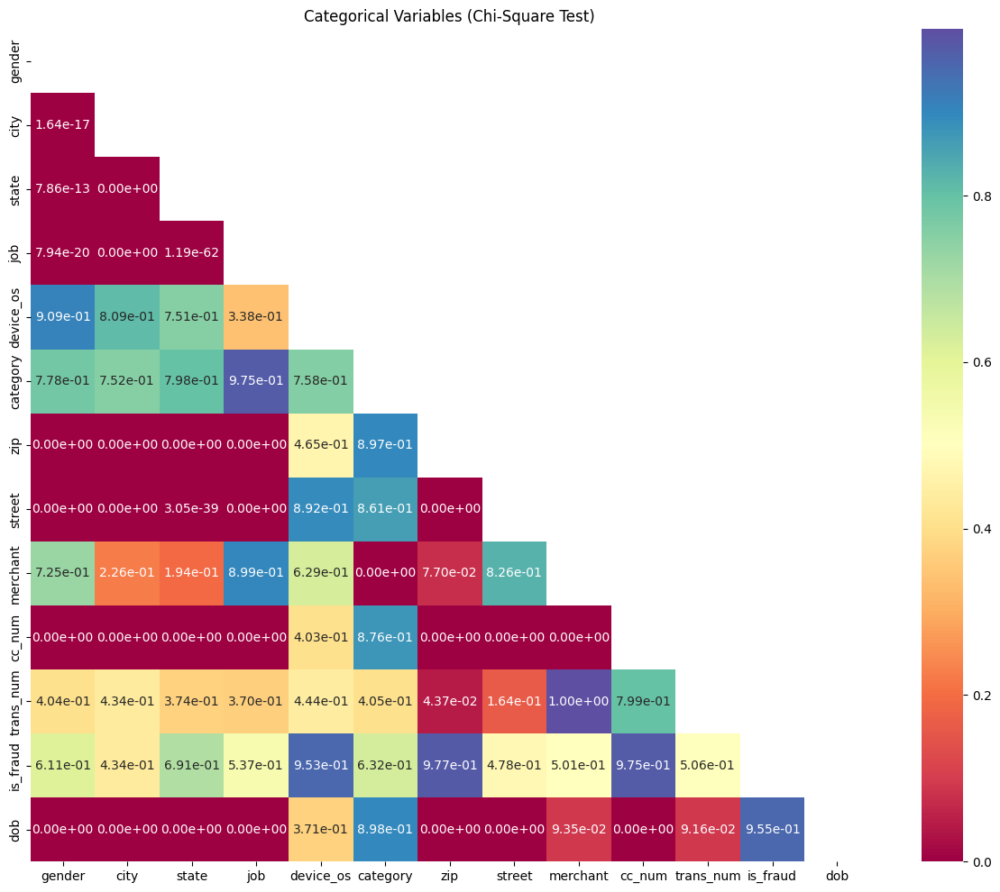

In [1307]:
categorical_vars = ['gender', 'city', 'state', 'job', 'device_os', 'category', 'zip', 'street', 'merchant', 'cc_num', 'trans_num', 'is_fraud', 'dob']
df_categorical = data[categorical_vars]

# Criar uma matriz para guardar os p-valores
p_values_matrix = pd.DataFrame(index=categorical_vars, columns=categorical_vars)

# Calcular o qui-quadrado para cada par de variáveis
for var1 in categorical_vars:
    for var2 in categorical_vars:
        if var1 == var2:
            p_values_matrix.loc[var1, var2] = np.nan  # Ignorar a diagonal principal
        else:
            contingency_table = pd.crosstab(df_categorical[var1], df_categorical[var2])
            try:
                _, p_value, _, _ = chi2_contingency(contingency_table)
                p_values_matrix.loc[var1, var2] = p_value
            except ValueError:
                p_values_matrix.loc[var1, var2] = np.nan  # Caso não seja possível calcular

# Converter os valores para float
p_values_matrix = p_values_matrix.astype(float)

# Retirar a parte superior da matriz
mask = np.tril(np.ones(p_values_matrix.shape), k=-1) 
p_values_matrix_masked = p_values_matrix.where(mask == 1)

# Criar heatmap
plt.figure(figsize=(15, 12))
sb.heatmap(p_values_matrix_masked, annot=True, fmt=".2e", cmap="Spectral", cbar=True)
plt.title("Categorical Variables (Chi-Square Test)")
plt.show()

Como a matriz de correlação das variáveis numéricas não apresenta correlações fortes, foi necessário analisar as variáveis categóricas para perceber se existe alguma relação importante.

A matriz apresenta *p-valores* para cada par de variáveis, indicando a probabilidade das variáveis serem independentes entre elas - hipótese *H0*. *p-valores* baixos sugerem que existe uma relação estatisticamente significativa entre as variáveis, enquanto p-valores altos indicam que não há evidências suficientes para rejeitar a hipótese *H0*. A coloração da matriz ilustra essas relações, com tons de vermelho indicado relações fortes de dependência e portanto rejeição da hipótese *H0* e os outros tons representam mais independência, logo não rejeitamos *H0*.

Relações fortes (p-valores muito baixos), como esperado, dada a correlação geográfica entre **street**, **state**, **city** e **zip**. Esses padrões podem ajudar a identificar locais de alto risco para fraudes. O **job** também apresenta *p-valores* baixos com varíaveis que representam a localização como **city**, **street** e **zip**. 

A categoria e o *id* do comerciante támbem parece estarem relacionados. 

Também se pode concluir que o **cc_num** está bastante relacionado com a **localização**, o **gender** e o **job** do utilizador.

Vamos verificar agora a qualidade dos dados antes de fazer a preparação dos mesmos. Pertende-se identificar erros e inconsistências nos dados, como valores ausentes, duplicados, entre outros.

In [1308]:
data.isnull().sum()

index                        0
trans_date_trans_time      100
cc_num                       0
device_os                17964
merchant                     0
amt                        100
trans_num                    0
unix_time                    0
is_fraud                     0
first                       10
last                        10
gender                      10
street                      10
city                        10
zip                        216
job                        216
dob                         10
lat                      19980
long                     19980
city_pop                 19980
state                    19980
category                   599
merch_lat                  599
merch_long                  10
merchant_id                 10
dtype: int64

Focando apenas nas variável mais relevantes, conseguimos verificar que existem alguns valores em falta em **amt**, **device_os**, **gender**, **city**, **job**, **dob** e **category**, entre outros. Estes valores em falta podem ser preenchidos, dependendo do tipo de variável e da sua distribuição na próxima etapa.

Podemos também verificar que, para atributos que representam essencialmente a mesma informação, há inconsistências nos valores ausentes. Por exemplo, no caso dos atributos **merchant** e **merchant_id**, observamos que existem valores ausentes em **merchant_id**, mas não em **merchant**. Portanto, optamos por manter o atributo **merchant**, que possui informações mais completas. Da mesma forma, para os atributos **trans_date_trans_time** e **unix_time**, verificamos que **unix_time** não apresenta valores ausentes, enquanto **trans_date_trans_time** possui. Assim, escolhemos o atributo **unix_time**. Na próxima fase trataremos de remover os que não são relevantes.

Identificamos que os atributos **lat** e **long** possuem uma quantidade significativa de valores ausentes. Além disso, a ampla distribuição desses valores torna inviável preenchê-los de forma consistente e coerente, sem introduzir vieses ou comprometer a qualidade dos dados. Por este motivo, decidimos remover esses atributos da análise. Da mesma forma, ao avaliar os atributos **merch_lat** e **merch_long**, verificamos que **merch_lat** apresenta ainda mais valores ausentes do que **merch_long**. Considerando essa inconsistência e a dificuldade de completar essas informações de maneira confiável, optamos por remover ambos os atributos relacionados com a localização do comerciante. A mesma justificação se aplica ao atributo **zip** e **street**.

In [1309]:
data.nunique()

index                    29970
trans_date_trans_time    29868
cc_num                    1101
device_os                    5
merchant                   101
amt                      22615
trans_num                29470
unix_time                29959
is_fraud                     2
first                      108
last                       108
gender                       2
street                     102
city                         6
zip                       1077
job                          7
dob                       1062
lat                          5
long                         5
city_pop                     5
state                        5
category                     5
merch_lat                   98
merch_long                 100
merchant_id                100
dtype: int64

In [1310]:
print(data.duplicated(subset='trans_num').sum())

530


In [1311]:
data['is_fraud'].unique()

array([0, 1], dtype=object)

In [1312]:
data['gender'].unique()

array(['F', 'M', nan], dtype=object)

In [1313]:
data['category'].unique()

array([nan, 'Entertainment', 'Electronics', 'Groceries', 'Apparel',
       'Travel'], dtype=object)

In [1314]:
data['job'].unique()

array([nan, 'Nurse', 'Doctor', 'Teacher', 'Engineer', 'Clerk', 'Artist',
       'Lawyer'], dtype=object)

In [1315]:
data['device_os'].unique()

array([nan, 'macOS', 'X11', 'other', 'Windows', 'Linux'], dtype=object)

In [1316]:
data['city'].unique()

array(['Chicago', 'New York', 'Phoenix', 'Los Angeles', 'Houston', nan,
       'Test City'], dtype=object)

Os valores do atributo **trans_num** deveriam ser todos únicos mas existem **530** repetidos. Os duplicados devem ser, portanto, removidos. 

Ficamos, também, com informação que os valores dos atributos categóricos descritos acima são todos plausíveis, não tendo erros de codificação ou valores inválidos.

O atributo booleano assume só valores de **0** ou **1**, o que é o esperado.

## Preparação dos Dados

Primeiramente, vamos remover os atributos que não são relevantes para o modelo, como já foi vista acima, e que não vamos utilizar para fazer **feature engineering**.

- justificar state e city_pop

In [1317]:
from scipy.stats import shapiro

stat, p = shapiro(data['amt'])
print('Shapiro-Wilk Test:')
print('Stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print("Provavelmente normal")
else:
    print("Provavelmente não normal")


Shapiro-Wilk Test:
Stat=nan, p=nan
Provavelmente não normal


In [1318]:
data = data.drop(columns= ['index', 'first', 'last', 'lat', 'long', 'merch_lat', 'merch_long', 'merchant_id', 'trans_date_trans_time', 'street', 'zip', 'state', 'city_pop'])

data.head()

,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,gender,city,job,dob,category
0,2801374844713453,NaN,Merchant_85,252.75,TRANS_662964,1672533543,0,F,Chicago,NaN,2002-10-12,NaN
1,3460245159749480,NaN,Merchant_23,340.17,TRANS_134939,1672535768,0,M,New York,Nurse,2001-12-23,Entertainment
2,7308701990157768,macOS,Merchant_70,76.38,TRANS_258923,1672536268,0,M,Phoenix,Doctor,1978-12-13,Electronics
3,8454886440761098,X11,Merchant_33,368.88,TRANS_226814,1672538817,0,F,Phoenix,Teacher,1965-04-21,Electronics
4,6350332939133843,NaN,Merchant_90,323.32,TRANS_668449,1672539054,0,F,New York,Nurse,1997-05-17,Groceries


Focando no atributo **trans_num**, a análise identificou **530** valores duplicados. Alguns correspondiam a linhas idênticas, permitindo a remoção de qualquer uma. No entanto, em casos onde as linhas apresentavam diferenças, como a presença de valores **NA**, priorizou-se a remoção das linhas com maior número de **NA**.

In [1319]:
data['num_na'] = data.isna().sum(axis=1)

# Selecionar a melhor linha para cada valor único no atributo
df_unico = data.loc[data.groupby('trans_num')['num_na'].idxmin()].reset_index(drop=True)

print(df_unico.duplicated(subset='trans_num').sum())

data = df_unico.drop(columns=['num_na', 'trans_num'])

0


In [1320]:
data['dob'] = pd.to_datetime(data['dob'])

# Calcular faixas etárias
def categorize_age(dob):
    today = datetime.today()
    age = today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))
    if 18 <= age <= 36:
        return 'Young Adult'
    elif 37 <= age <= 55:
        return 'Adult'
    elif 56 <= age <= 74:
        return 'Middle Age'
    else:
        return 'Senior'

# Aplicar a função para categorizar as faixas etárias
data['age_category'] = data['dob'].apply(categorize_age)
data.drop(columns=['dob'], inplace=True)

Quantas transações entre o cliente e o comerciante ocorreram até à data da transação.

In [1321]:
data = data.sort_values(by=['unix_time'])

# Criar a coluna de contagem acumulada
data['transactions_count'] = (
    data.groupby(['cc_num', 'merchant'])['unix_time']
      .cumcount() 
)

data['transactions_count'] = data['transactions_count'] + 1  # Começar a contagem em 1

Quantos merchants diferentes é que o cliente fez transações até à data da transação.

In [1322]:
unique_merchants = set()
unique_merchants_count = []

for merchant in data['merchant']:
    unique_merchants.add(merchant)  # Adicionar o comerciante ao conjunto
    unique_merchants_count.append(len(unique_merchants))  # Contar os únicos até ao momento

data['unique_merchants_count'] = unique_merchants_count

data = data.drop(columns=['merchant'])

In [ ]:
data['datetime'] = pd.to_datetime(data['unix_time'], unit='s')

#Calcular o tempo desde a última transação =====
data.sort_values(by=['cc_num', 'datetime'], inplace=True)
data['time_since_last'] = data.groupby('cc_num')['datetime'].diff().dt.total_seconds()
data['time_since_last'] = data['time_since_last'].fillna(0)

data['hour'] = data['datetime'].dt.hour

#Categorizar período do dia 
def categorize_period(hour):
    if 0 <= hour < 8:
        return 'Madrugada'
    elif 8 <= hour < 13:
        return 'Manhã'
    elif 13 <= hour < 18:
        return 'Tarde'
    else:
        return 'Noite'

data['period_of_day'] = data['hour'].apply(categorize_period)

#Adicionar dia da semana
data['day_of_week'] = data['datetime'].dt.day_name()

#Transformar dia da semana em variáveis cíclicas
day_mapping = {'Sunday': 0, 'Monday': 1, 'Tuesday': 2, 'Wednesday': 3,
               'Thursday': 4, 'Friday': 5, 'Saturday': 6}
data['day_of_week_num'] = data['day_of_week'].map(day_mapping)
data['day_of_week_sin'] = np.sin(2 * np.pi * data['day_of_week_num'] / 7)
data['day_of_week_cos'] = np.cos(2 * np.pi * data['day_of_week_num'] / 7)

#Transformar período do dia em variáveis cíclicas
period_mapping = {'Madrugada': 0, 'Manhã': 1, 'Tarde': 2, 'Noite': 3}
data['period_of_day_num'] = data['period_of_day'].map(period_mapping)
data['period_of_day_sin'] = np.sin(2 * np.pi * data['period_of_day_num'] / 4)
data['period_of_day_cos'] = np.cos(2 * np.pi * data['period_of_day_num'] / 4)

data = data.drop(columns=['hour', 'day_of_week', 'day_of_week_num', 
                          'period_of_day', 'period_of_day_num', 'datetime', 'unix_time', 'cc_num'])

In [1325]:
all_inputs = data.drop(['is_fraud'], axis = 1)

all_labels = data['is_fraud'] 
(training_inputs, testing_inputs, training_classes, testing_classes) = train_test_split(all_inputs, all_labels, test_size = 0.25, random_state = 42, stratify=all_labels)

In [ ]:
unimputed_data = training_inputs.copy()

unimputed_data.to_csv('CreditCardTransactions/unimputed_data.csv', index=False)

Código feito em R para imputar os valores em falta para as variáveis

In [ ]:
'''
library(VIM)
setwd("C:/Users/Matilde/Documents/GitHub/Credit-Card-Fraud-Detection/CreditCardTransactions")
data <- read.csv("imputed_data.csv", na.strings = c("NA", "?", ""))
numeric_cols <- sapply(data, is.numeric)
scaling_params <- data.frame(
    mean = sapply(data[, numeric_cols], mean, na.rm = TRUE),
    sd = sapply(data[, numeric_cols], sd, na.rm = TRUE)
)


data[numeric_cols] <- scale(data[numeric_cols])
data_imputed <- kNN(data, k = 5)
data_imputed <- data_imputed[, !grepl("_imp", names(data_imputed))]

for (col in names(data)[numeric_cols]) {
    data_imputed[[col]] <- (data_imputed[[col]] * scaling_params[col, "sd"]) + scaling_params[col, "mean"]
}
write.csv(data_imputed, "new_data.csv", row.names = FALSE, quote = FALSE)
'''

'\nlibrary(VIM)\nsetwd("C:/Users/Matilde/Documents/GitHub/Credit-Card-Fraud-Detection")\ndata <- read.csv("imputed_data.csv", na.strings = c("NA", "?", ""))\nnumeric_cols <- sapply(data, is.numeric)\nscaling_params <- data.frame(\n    mean = sapply(data[, numeric_cols], mean, na.rm = TRUE),\n    sd = sapply(data[, numeric_cols], sd, na.rm = TRUE)\n)\n\n\ndata[numeric_cols] <- scale(data[numeric_cols])\ndata_imputed <- kNN(data, k = 5)\ndata_imputed <- data_imputed[, !grepl("_imp", names(data_imputed))]\n\nfor (col in names(data)[numeric_cols]) {\n    data_imputed[[col]] <- (data_imputed[[col]] * scaling_params[col, "sd"]) + scaling_params[col, "mean"]\n}\nwrite.csv(data_imputed, "new_data.csv", row.names = FALSE, quote = FALSE)\n'

In [1328]:
training_inputs = pd.read_csv('new_data.csv')

In [1329]:
'''
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler

# Supondo que 'training_inputs' seja seu DataFrame original
# E você já executou o pré-processamento conforme fornecido

clustering_columns = ['device_os', 'amt', 'unix_time']
clustering_data = training_inputs[clustering_columns].copy()

# Identificar as colunas numéricas e categóricas
numerical_features = ['amt', 'unix_time']
categorical_features = ['device_os']

# Aplicar o escalonamento
scaler = StandardScaler()
clustering_data[numerical_features] = scaler.fit_transform(clustering_data[numerical_features])

# Aplicar one-hot encoding nas colunas categóricas
clustering_data = pd.get_dummies(clustering_data, drop_first=True, dtype=int)

clustering_data.head()

# Determinar o valor de k para o gráfico k-distance
# Normalmente, k é igual ao MinPts do DBSCAN. Um valor comum para MinPts é o número de dimensões + 1
k = 7  # Ajuste conforme necessário

# Calcular as distâncias para os k-ésimos vizinhos mais próximos
neighbors = NearestNeighbors(n_neighbors=k)
neighbors_fit = neighbors.fit(clustering_data)
distances, indices = neighbors_fit.kneighbors(clustering_data)

# Selecionar apenas as distâncias do k-ésimo vizinho
k_distances = distances[:, k-1]

# Ordenar as distâncias de forma crescente
k_distances_sorted = np.sort(k_distances)

# Plotar o gráfico k-distance
plt.figure(figsize=(10, 6))
plt.plot(k_distances_sorted)
plt.ylabel(f'Distância ao {k}-ésimo vizinho')
plt.xlabel('Pontos ordenados por distância')
plt.title(f'Gráfico k-distance (k={k})')
plt.grid(True)
plt.show()
'''


"\nimport numpy as np\nimport pandas as pd\nimport matplotlib.pyplot as plt\nfrom sklearn.neighbors import NearestNeighbors\nfrom sklearn.preprocessing import StandardScaler\n\n# Supondo que 'training_inputs' seja seu DataFrame original\n# E você já executou o pré-processamento conforme fornecido\n\nclustering_columns = ['device_os', 'amt', 'unix_time']\nclustering_data = training_inputs[clustering_columns].copy()\n\n# Identificar as colunas numéricas e categóricas\nnumerical_features = ['amt', 'unix_time']\ncategorical_features = ['device_os']\n\n# Aplicar o escalonamento\nscaler = StandardScaler()\nclustering_data[numerical_features] = scaler.fit_transform(clustering_data[numerical_features])\n\n# Aplicar one-hot encoding nas colunas categóricas\nclustering_data = pd.get_dummies(clustering_data, drop_first=True, dtype=int)\n\nclustering_data.head()\n\n# Determinar o valor de k para o gráfico k-distance\n# Normalmente, k é igual ao MinPts do DBSCAN. Um valor comum para MinPts é o núme

In [1330]:
'''
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
import seaborn as sns

# Definir os parâmetros do DBSCAN
epsilon = 0.15  # Substitua pelo valor identificado no gráfico k-distance
min_samples = k  # Normalmente igual a k

# Inicializar e ajustar o DBSCAN
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples, metric='euclidean')
dbscan.fit(clustering_data)

# Obter os rótulos dos clusters
labels = dbscan.labels_

# Adicionar os rótulos ao DataFrame original
clustering_data['Cluster'] = labels

# Contar o número de pontos em cada cluster
print(clustering_data['Cluster'].value_counts())
'''


"\nfrom sklearn.cluster import DBSCAN\nfrom sklearn.decomposition import PCA\nimport seaborn as sns\n\n# Definir os parâmetros do DBSCAN\nepsilon = 0.15  # Substitua pelo valor identificado no gráfico k-distance\nmin_samples = k  # Normalmente igual a k\n\n# Inicializar e ajustar o DBSCAN\ndbscan = DBSCAN(eps=epsilon, min_samples=min_samples, metric='euclidean')\ndbscan.fit(clustering_data)\n\n# Obter os rótulos dos clusters\nlabels = dbscan.labels_\n\n# Adicionar os rótulos ao DataFrame original\nclustering_data['Cluster'] = labels\n\n# Contar o número de pontos em cada cluster\nprint(clustering_data['Cluster'].value_counts())\n"

In [1331]:
'''
# Número de clusters encontrados (excluindo o ruído)
n_clusters = len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0)
# Número de pontos de ruído
n_noise = list(dbscan.labels_).count(-1)

print(f'Número de clusters encontrados: {n_clusters}')
print(f'Número de pontos de ruído: {n_noise}')
'''

"\n# Número de clusters encontrados (excluindo o ruído)\nn_clusters = len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0)\n# Número de pontos de ruído\nn_noise = list(dbscan.labels_).count(-1)\n\nprint(f'Número de clusters encontrados: {n_clusters}')\nprint(f'Número de pontos de ruído: {n_noise}')\n"

In [1332]:
'''
X = clustering_data.drop(columns=['Cluster'])

# Verifique se há mais de 1 cluster para calcular o Silhouette Score
if n_clusters > 1:
    # Excluir pontos de ruído para o cálculo
    mask = dbscan.labels_ != -1
    silhouette_avg = silhouette_score(X[mask], dbscan.labels_[mask])
    print(f'Silhouette Score: {silhouette_avg:.3f}')
else:
    print('Silhouette Score não pode ser calculado com menos de 2 clusters.')
'''

"\nX = clustering_data.drop(columns=['Cluster'])\n\n# Verifique se há mais de 1 cluster para calcular o Silhouette Score\nif n_clusters > 1:\n    # Excluir pontos de ruído para o cálculo\n    mask = dbscan.labels_ != -1\n    silhouette_avg = silhouette_score(X[mask], dbscan.labels_[mask])\n    print(f'Silhouette Score: {silhouette_avg:.3f}')\nelse:\n    print('Silhouette Score não pode ser calculado com menos de 2 clusters.')\n"

In [1333]:
# Identificar colunas numéricas e categóricas
numerical_cols = training_inputs.select_dtypes(include=['number']).columns
categorical_cols = training_inputs.select_dtypes(include=['object', 'category']).columns

# Calcular a média e a moda a partir do conjunto de treino
mean_values = training_inputs[numerical_cols].mean()
mode_values = training_inputs[categorical_cols].mode().iloc[0]

# Imputar os valores faltantes no conjunto de teste
testing_inputs[numerical_cols] = testing_inputs[numerical_cols].fillna(mean_values)
testing_inputs[categorical_cols] = testing_inputs[categorical_cols].fillna(mode_values)

# Opcional: Verificar se ainda existem valores faltantes
print(testing_inputs.isnull().sum())

KeyError: "['unix_time', 'dob', 'city_pop'] not in index"

Quantifique a proporção de transações por cidade em relação ao total de transações no dataset.
Comparação da taxa de fraudes da cidade com a média global.

In [ ]:
'''
data['city_transaction_ratio'] = data.groupby('city')['city'].transform('count') / len(data)
data['city_fraud_rate'] = data.groupby('city')['is_fraud'].transform('mean')

global_fraud_rate = data['is_fraud'].mean()

data['city_vs_global_fraud_rate'] = data['city_fraud_rate'] - global_fraud_rate

data.drop(columns=['city'], inplace=True)
data.head(10)
'''

In [ ]:
training_inputs = pd.get_dummies(training_inputs['gender'], drop_first=True, dtype=int)
testing_inputs = pd.get_dummies(testing_inputs['gender'], drop_first=True, dtype=int)

training_inputs = pd.get_dummies(training_inputs['device_os', 'category', 'age_category', 'job'], drop_first=False, dtype=int)
testing_inputs = pd.get_dummies(testing_inputs['device_os', 'category', 'age_category', 'job'], drop_first=False, dtype=int)

In [ ]:
training_inputs.head(10)

,amt,unix_time,dob,city_pop,transactions_count,device_os_Windows,device_os_X11,device_os_macOS,device_os_other,gender_M,...,job_Nurse,job_Teacher,state_CA,state_IL,state_NY,state_TX,category_Electronics,category_Entertainment,category_Groceries,category_Travel
0,22.34,1723057264,37,2716000,3,1,0,0,0,1,...,0,0,0,1,0,0,1,0,0,0
1,264.07,1720297692,70,2716000,2,0,0,0,1,0,...,0,0,0,1,0,0,0,1,0,0
2,318.51,1690835272,69,8419600,1,0,0,1,0,1,...,0,0,0,0,1,0,0,0,0,1
3,169.30,1700058034,57,2716000,1,0,0,0,1,0,...,0,1,0,1,0,0,0,1,0,0
4,424.55,1714398733,42,2716000,1,0,0,0,1,1,...,0,0,0,1,0,0,0,0,0,1
5,332.74,1699375475,56,3979576,1,0,0,0,1,0,...,0,0,1,0,0,0,0,0,0,0
6,336.62,1714531594,46,2716000,1,1,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
7,230.46,1729882124,48,2716000,2,1,0,0,0,0,...,0,1,0,1,0,0,0,1,0,0
8,72.13,1721843224,33,2716000,2,0,0,1,0,0,...,0,1,0,1,0,0,0,0,0,1
9,315.38,1694453746,67,2328000,1,0,1,0,0,0,...,0,0,0,0,0,1,0,0,1,0


Terminadas as etapas de análise e preparação dos dados, vamos agora guardar o *dataset* limpo e preparado para as próximas etapas.

In [ ]:
training_inputs.to_csv('CreditCardTransactions/training_dataset.csv', index=False)
testing_inputs.to_csv('CreditCardTransactions/testing_dataset.csv', index=False)
training_classes.to_csv('CreditCardTransactions/training_classes.csv', index=False)
testing_classes.to_csv('CreditCardTransactions/testing_classes.csv', index=False)